In [1]:
#Heavy Decoder 
#BottleNeck: 16

In [2]:
#Disable Warning
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'
import warnings
warnings.filterwarnings("ignore")

In [3]:
FILE1 = 'SB-001_normalized_AM.csv'
FILE2 = 'SB-001_normalized_PM.csv'
NO_OF_COLUMNS = 24

In [4]:
#pip install tf2onnx
import tensorflow as tf
from tensorflow import keras
import seaborn as sns
import matplotlib.pyplot as plt
plt.ioff()
import cv2
import IPython
from tqdm import tqdm
import time
import os
import pickle
import pandas as pd
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
import warnings
warnings.filterwarnings("ignore")
warnings.filterwarnings('ignore', message=r'.*Consider either turning off auto-sharding.*')

In [5]:
run_summary = []

In [6]:
def generate_autoencoder_reports(encoder_dense_layers, bottle_neck, decoder_dense_layers):

    print(encoder_dense_layers, bottle_neck, decoder_dense_layers)
    # Load Data
    df_am = pd.read_csv(FILE1)
    df_pm = pd.read_csv(FILE2)
    combined_df = pd.concat([df_am, df_pm])

    columns_needed = ['y_am_pef', 'tempin', 'humidin', 'pm25in', 'co2in', 'tempdiffin', 'humidiffin', 'pm25diffin',
                      'pm10', 'pm25', 'o3', 'no2', 'co', 'so2', 'temp', 'windsd', 'humid', 'varp', 'dewpt', 'airp',
                      'seap', 'solrhr', 'solramnt', 'grdt', 'class']
    combined_df = combined_df.filter(columns_needed)
    df = combined_df.sample(frac=1, random_state=42).reset_index(drop=True)

    # Drop NaN
    df = df.dropna()

    # Minotity Split
    class_counts = df['class'].value_counts()
    minority_class = df[df['class'] == 0]
    majority_class = df[df['class'] == 1]

    # Removing class column from minority before augmentation
    X = minority_class.drop('class', axis=1)
    y = minority_class['class']

    # Saving minority as X_train
    X_train = X

    # Define the Input shape
    INPUT_SHAPE = X_train.shape[1]
    FILE_NAME = f"L{INPUT_SHAPE}_E{'_'.join(map(str, encoder_dense_layers))}_B{bottle_neck}_D{'_'.join(map(str, decoder_dense_layers))}"
    print("\n" + FILE_NAME + "\n")
    
    def build_autoencoder(input_shape, **kwargs):

        # Autoencoder model construction cod

      """
      Build an autoencoder model with the given configuration.

      Args:
          input_shape (int): The shape of the input data.
          **kwargs: Additional keyword arguments for configuring the autoencoder.

      Keyword Args:
          encoder_dense_layers (list): List of integers specifying the number of units for each dense layer in the encoder.
                                      Default: []
          bottle_neck (int): The number of units in the bottleneck layer. Default: input_shape // 2
          decoder_dense_layers (list): List of integers specifying the number of units for each dense layer in the decoder.
                                      Default: []
          decoder_activation (str): The activation function for the decoder output layer. Default: 'sigmoid'

      Returns:
          tuple: A tuple containing the autoencoder, encoder, and decoder models.

      Example:
          INPUT_SHAPE = 27
          encoder_dense_layers = [20, 18]  # Specify the number of units for each dense layer in the encoder
          bottle_neck = 16
          decoder_dense_layers = [18, 20]  # Specify the number of units for each dense layer in the decoder

          autoencoder, encoder, decoder = build_autoencoder(INPUT_SHAPE, encoder_dense_layers=encoder_dense_layers,
                                                            bottle_neck=bottle_neck, decoder_dense_layers=decoder_dense_layers)
          encoder.summary()
          decoder.summary()
          autoencoder.summary()
      """

      # Default parameter values
      encoder_dense_layers = kwargs.get('encoder_dense_layers', [])
      bottle_neck = kwargs.get('bottle_neck', input_shape // 2)
      decoder_dense_layers = kwargs.get('decoder_dense_layers', [])
      decoder_activation = kwargs.get('decoder_activation', 'sigmoid')

      # Autoencoder Model
      encoder_input = keras.Input(shape=(input_shape,), name="encoder")
      x = keras.layers.Flatten()(encoder_input)

      # Encoder Dense Layers
      for units in encoder_dense_layers:
          x = keras.layers.Dense(units, activation="relu")(x)

      encoder_output = keras.layers.Dense(bottle_neck, activation="relu")(x)
      encoder = keras.Model(encoder_input, encoder_output, name="encoder")

      # Decoder Model
      decoder_input = keras.Input(shape=(bottle_neck,), name="decoder")
      x = decoder_input

      # Decoder Dense Layers
      for units in decoder_dense_layers:
          x = keras.layers.Dense(units, activation="relu")(x)

      decoder_output = keras.layers.Dense(input_shape, activation=decoder_activation)(x)
      decoder = keras.Model(decoder_input, decoder_output, name="decoder")

      # Autoencoder Model
      autoencoder_input = keras.Input(shape=(input_shape,), name="input")
      encoded = encoder(autoencoder_input)
      decoded = decoder(encoded)
      autoencoder = keras.Model(autoencoder_input, decoded, name="autoencoder")

      return autoencoder, encoder, decoder

    autoencoder, encoder, decoder = build_autoencoder(INPUT_SHAPE, encoder_dense_layers=encoder_dense_layers,
                                                      bottle_neck=bottle_neck,
                                                      decoder_dense_layers=decoder_dense_layers)
    opt = keras.optimizers.Adam(learning_rate=0.001)
    autoencoder.compile(opt, loss="mse")

    print("Training model:", FILE_NAME)
    history = autoencoder.fit(X_train, X_train, epochs=200, batch_size=16, validation_split=0.25, verbose=0)
    print("Training Complete:")
    
    # Extract the loss values
    loss = history.history['loss']
    val_loss = history.history['val_loss']

    # Print the last epoch's loss values
    last_epoch_loss = loss[-1]
    last_epoch_val_loss = val_loss[-1]
    print("Last epoch loss:", last_epoch_loss)
    print("Last epoch validation loss:", last_epoch_val_loss)

    # Saving history
    with open(FILE_NAME + '_history.pickle', 'wb') as file:
        pickle.dump(history.history, file)

    # Visualize losses *(MSE)
    train_loss = history.history['loss']
    val_loss = history.history['val_loss']
    epochs = range(1, len(train_loss) + 1)
    plt.plot(epochs, train_loss, 'b', label='Training Loss')
    plt.plot(epochs, val_loss, 'r', label='Validation Loss')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.savefig(FILE_NAME + 'Loss.png')
    #plt.show()

    # Generate synthetic data
    num_samples = len(X_train)
    input_data = np.random.normal(size=(num_samples, INPUT_SHAPE))
    generated_data = autoencoder.predict(input_data)
    reshaped_data = generated_data.reshape(num_samples, -1)
    df_generated = pd.DataFrame(reshaped_data, columns=X_train.columns)

    # Plot correlation matrices
    corr_matrix1 = X_train.corr()
    corr_matrix2 = df_generated.corr()

    fig, axes = plt.subplots(1, 2, figsize=(18, 10))
    sns.heatmap(corr_matrix1, annot=True, cmap='coolwarm', ax=axes[0])
    axes[0].set_title('Heatmap 1')

    sns.heatmap(corr_matrix2, annot=True, cmap='coolwarm', ax=axes[1])
    axes[1].set_title('Heatmap 2')

    plt.tight_layout()
    plt.savefig(FILE_NAME + 'HeatMaps')
    #plt.show()

    # Calculate mean and standard deviation of original and synthetic datasets
    common_columns = set(X_train.columns) & set(df_generated.columns)
    results = {}

    for column in common_columns:
        mean_df1 = X_train[column].mean()
        std_df1 = X_train[column].std()
        mean_df2 = df_generated[column].mean()
        std_df2 = df_generated[column].std()

        results[column] = {'Mean_df1': mean_df1, 'Std_df1': std_df1,
                           'Mean_df2': mean_df2, 'Std_df2': std_df2}

    comparison_df = pd.DataFrame(results)
    comparison_df.to_csv(FILE_NAME + 'mean_std.csv', index=True)

    # Plot scatter plots
    new_index = pd.RangeIndex(start=0, stop=57, step=1)
    X_train = X_train.set_index(new_index)
    common_columns = set(X_train.columns) & set(df_generated.columns)

    for column in common_columns:
        plt.scatter(X_train.index, X_train[column], color='red', label='X_train')
        plt.scatter(df_generated.index, df_generated[column], color='blue', label='df_generated')

        plt.title(f"Scatter Plot: {column}")
        plt.xlabel("Index")
        plt.ylabel(column)

        plt.legend()
        plt.savefig(FILE_NAME + "_" + column)
        #plt.show()


    # Add back the class label
    X_train['class'] = 0.0
    df_generated['class'] = 0.0
    X_train.to_csv(FILE_NAME + 'Original_minority_data.csv', index=False)
    df_generated.to_csv(FILE_NAME + 'Synthetic_minority_data.csv', index=False)

    # Generate quality report and display it
    real_data = FILE_NAME + 'Original_minority_data.csv'
    synth_data = FILE_NAME + 'Synthetic_minority_data.csv'

    # report = QualityReport(data_source=synth_data, ref_data=real_data)
    # report.run()

    # print(report.peek())
    #run_summary.append([FILE_NAME, report.peek()['raw_score'], report.peek()['grade']])
    run_summary.append([FILE_NAME, last_epoch_loss, last_epoch_val_loss])

    print("Reports Saved")
    #IPython.display.HTML(report.as_html, metadata=dict(isolated=True))
    return None

In [7]:
# Example usage
def runner(encoder_dense_layers, bottle_neck, decoder_dense_layers):
  #encoder_dense_layers = [10, 8]
  #bottle_neck = 5
  #decoder_dense_layers = [8, 10]
  #FILE_NAME = f"24_{'_'.join(map(str, encoder_dense_layers))}_{bottle_neck}_"
  FILE_NAME = f"L{NO_OF_COLUMNS}_E{'_'.join(map(str, encoder_dense_layers))}_B{bottle_neck}_D{'_'.join(map(str, decoder_dense_layers))}"   
  report = generate_autoencoder_reports(encoder_dense_layers, bottle_neck, decoder_dense_layers)
  #print(type(report))
  # Save the report object to a file
  # with open(FILE_NAME + 'quality_report.pickle', 'wb') as file:
  #     pickle.dump(report, file)

  #IPython.display.HTML(report.as_html, metadata=dict(isolated=True))

In [8]:
# here goes nothin

In [9]:
encoder_dense_layers_trial = [[10, 8], [12, 10], [14, 12], [16, 14], [18, 16], [20, 18],[22, 20]]
decoder_dense_layers_trial = [[6, 8, 10, 12], [8, 10, 12, 14], [10, 12, 14, 16], [12, 14, 16, 18], [14, 16, 18, 20], 
                              [16, 18, 20, 22], [18, 20, 22, 24]]
bottle_neck_trial = [16]

In [10]:
total_iterations = len(bottle_neck_trial) * len(encoder_dense_layers_trial) * len(decoder_dense_layers_trial)
print("Total Model in Pipeline:",total_iterations)

# Print total models
for bn in bottle_neck_trial:
  for enc_layers in encoder_dense_layers_trial:
      for dec_layers in decoder_dense_layers_trial:
          print(enc_layers, bn, dec_layers)

Total Model in Pipeline: 49
[10, 8] 16 [6, 8, 10, 12]
[10, 8] 16 [8, 10, 12, 14]
[10, 8] 16 [10, 12, 14, 16]
[10, 8] 16 [12, 14, 16, 18]
[10, 8] 16 [14, 16, 18, 20]
[10, 8] 16 [16, 18, 20, 22]
[10, 8] 16 [18, 20, 22, 24]
[12, 10] 16 [6, 8, 10, 12]
[12, 10] 16 [8, 10, 12, 14]
[12, 10] 16 [10, 12, 14, 16]
[12, 10] 16 [12, 14, 16, 18]
[12, 10] 16 [14, 16, 18, 20]
[12, 10] 16 [16, 18, 20, 22]
[12, 10] 16 [18, 20, 22, 24]
[14, 12] 16 [6, 8, 10, 12]
[14, 12] 16 [8, 10, 12, 14]
[14, 12] 16 [10, 12, 14, 16]
[14, 12] 16 [12, 14, 16, 18]
[14, 12] 16 [14, 16, 18, 20]
[14, 12] 16 [16, 18, 20, 22]
[14, 12] 16 [18, 20, 22, 24]
[16, 14] 16 [6, 8, 10, 12]
[16, 14] 16 [8, 10, 12, 14]
[16, 14] 16 [10, 12, 14, 16]
[16, 14] 16 [12, 14, 16, 18]
[16, 14] 16 [14, 16, 18, 20]
[16, 14] 16 [16, 18, 20, 22]
[16, 14] 16 [18, 20, 22, 24]
[18, 16] 16 [6, 8, 10, 12]
[18, 16] 16 [8, 10, 12, 14]
[18, 16] 16 [10, 12, 14, 16]
[18, 16] 16 [12, 14, 16, 18]
[18, 16] 16 [14, 16, 18, 20]
[18, 16] 16 [16, 18, 20, 22]
[18, 16]

[10, 8] 16 [6, 8, 10, 12]
[10, 8] 16 [6, 8, 10, 12]

L24_E10_8_B16_D6_8_10_12

Training model: L24_E10_8_B16_D6_8_10_12
Training Complete:
Last epoch loss: 0.01924319937825203
Last epoch validation loss: 0.031772904098033905
Reports Saved
[10, 8] 16 [8, 10, 12, 14]
[10, 8] 16 [8, 10, 12, 14]

L24_E10_8_B16_D8_10_12_14

Training model: L24_E10_8_B16_D8_10_12_14
Training Complete:
Last epoch loss: 0.008971761912107468
Last epoch validation loss: 0.015571190044283867
Reports Saved
[10, 8] 16 [10, 12, 14, 16]
[10, 8] 16 [10, 12, 14, 16]

L24_E10_8_B16_D10_12_14_16

Training model: L24_E10_8_B16_D10_12_14_16
Training Complete:
Last epoch loss: 0.017910106107592583
Last epoch validation loss: 0.02662251517176628
Reports Saved
[10, 8] 16 [12, 14, 16, 18]
[10, 8] 16 [12, 14, 16, 18]

L24_E10_8_B16_D12_14_16_18

Training model: L24_E10_8_B16_D12_14_16_18
Training Complete:
Last epoch loss: 0.01793283224105835
Last epoch validation loss: 0.027617322281003
Reports Saved
[10, 8] 16 [14, 16, 18, 20

Reports Saved
[12, 10] 16 [16, 18, 20, 22]
[12, 10] 16 [16, 18, 20, 22]

L24_E12_10_B16_D16_18_20_22

Training model: L24_E12_10_B16_D16_18_20_22
Training Complete:
Last epoch loss: 0.010889174416661263
Last epoch validation loss: 0.018488753587007523
Reports Saved
[12, 10] 16 [18, 20, 22, 24]
[12, 10] 16 [18, 20, 22, 24]

L24_E12_10_B16_D18_20_22_24

Training model: L24_E12_10_B16_D18_20_22_24
Training Complete:
Last epoch loss: 0.0066992961801588535
Last epoch validation loss: 0.013336870819330215
Reports Saved
[14, 12] 16 [6, 8, 10, 12]
[14, 12] 16 [6, 8, 10, 12]

L24_E14_12_B16_D6_8_10_12

Training model: L24_E14_12_B16_D6_8_10_12
Training Complete:
Last epoch loss: 0.009549411945044994
Last epoch validation loss: 0.01588370092213154
Reports Saved
[14, 12] 16 [8, 10, 12, 14]
[14, 12] 16 [8, 10, 12, 14]

L24_E14_12_B16_D8_10_12_14

Training model: L24_E14_12_B16_D8_10_12_14
Training Complete:
Last epoch loss: 0.018290258944034576
Last epoch validation loss: 0.028182514011859894
Repo

Reports Saved
[16, 14] 16 [6, 8, 10, 12]
[16, 14] 16 [6, 8, 10, 12]

L24_E16_14_B16_D6_8_10_12

Training model: L24_E16_14_B16_D6_8_10_12
Training Complete:
Last epoch loss: 0.014730975963175297
Last epoch validation loss: 0.0250517800450325
Reports Saved
[16, 14] 16 [8, 10, 12, 14]
[16, 14] 16 [8, 10, 12, 14]

L24_E16_14_B16_D8_10_12_14

Training model: L24_E16_14_B16_D8_10_12_14
Training Complete:
Last epoch loss: 0.011346896179020405
Last epoch validation loss: 0.023730354383587837
Reports Saved
[16, 14] 16 [10, 12, 14, 16]
[16, 14] 16 [10, 12, 14, 16]

L24_E16_14_B16_D10_12_14_16

Training model: L24_E16_14_B16_D10_12_14_16
Training Complete:
Last epoch loss: 0.017954345792531967
Last epoch validation loss: 0.02919999696314335
Reports Saved
[16, 14] 16 [12, 14, 16, 18]
[16, 14] 16 [12, 14, 16, 18]

L24_E16_14_B16_D12_14_16_18

Training model: L24_E16_14_B16_D12_14_16_18
Training Complete:
Last epoch loss: 0.008034727536141872
Last epoch validation loss: 0.01414694543927908
Reports 

Reports Saved
[18, 16] 16 [10, 12, 14, 16]
[18, 16] 16 [10, 12, 14, 16]

L24_E18_16_B16_D10_12_14_16

Training model: L24_E18_16_B16_D10_12_14_16
Training Complete:
Last epoch loss: 0.008685777895152569
Last epoch validation loss: 0.016427548602223396
Reports Saved
[18, 16] 16 [12, 14, 16, 18]
[18, 16] 16 [12, 14, 16, 18]

L24_E18_16_B16_D12_14_16_18

Training model: L24_E18_16_B16_D12_14_16_18
Training Complete:
Last epoch loss: 0.010964803397655487
Last epoch validation loss: 0.019863300025463104
Reports Saved
[18, 16] 16 [14, 16, 18, 20]
[18, 16] 16 [14, 16, 18, 20]

L24_E18_16_B16_D14_16_18_20

Training model: L24_E18_16_B16_D14_16_18_20
Training Complete:
Last epoch loss: 0.008234269917011261
Last epoch validation loss: 0.014127890579402447
Reports Saved
[18, 16] 16 [16, 18, 20, 22]
[18, 16] 16 [16, 18, 20, 22]

L24_E18_16_B16_D16_18_20_22

Training model: L24_E18_16_B16_D16_18_20_22
Training Complete:
Last epoch loss: 0.0070635294541716576
Last epoch validation loss: 0.0154734728

Reports Saved
[20, 18] 16 [14, 16, 18, 20]
[20, 18] 16 [14, 16, 18, 20]

L24_E20_18_B16_D14_16_18_20

Training model: L24_E20_18_B16_D14_16_18_20
Training Complete:
Last epoch loss: 0.00775908911600709
Last epoch validation loss: 0.013330376707017422
Reports Saved
[20, 18] 16 [16, 18, 20, 22]
[20, 18] 16 [16, 18, 20, 22]

L24_E20_18_B16_D16_18_20_22

Training model: L24_E20_18_B16_D16_18_20_22
Training Complete:
Last epoch loss: 0.007215609308332205
Last epoch validation loss: 0.01372758112847805
Reports Saved
[20, 18] 16 [18, 20, 22, 24]
[20, 18] 16 [18, 20, 22, 24]

L24_E20_18_B16_D18_20_22_24

Training model: L24_E20_18_B16_D18_20_22_24
Training Complete:
Last epoch loss: 0.009972167201340199
Last epoch validation loss: 0.018072647973895073
Reports Saved
[22, 20] 16 [6, 8, 10, 12]
[22, 20] 16 [6, 8, 10, 12]

L24_E22_20_B16_D6_8_10_12

Training model: L24_E22_20_B16_D6_8_10_12
Training Complete:
Last epoch loss: 0.015576638281345367
Last epoch validation loss: 0.02483651041984558
Rep

Reports Saved
[22, 20] 16 [18, 20, 22, 24]
[22, 20] 16 [18, 20, 22, 24]

L24_E22_20_B16_D18_20_22_24

Training model: L24_E22_20_B16_D18_20_22_24
Training Complete:
Last epoch loss: 0.006754106841981411
Last epoch validation loss: 0.014231541194021702
Reports Saved
Total time: 48.02870877981186 minutes


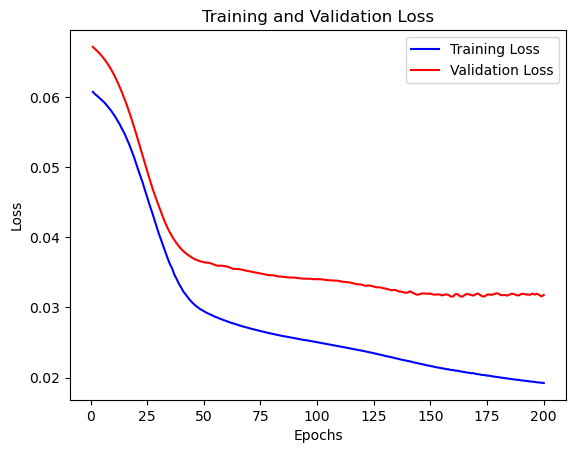

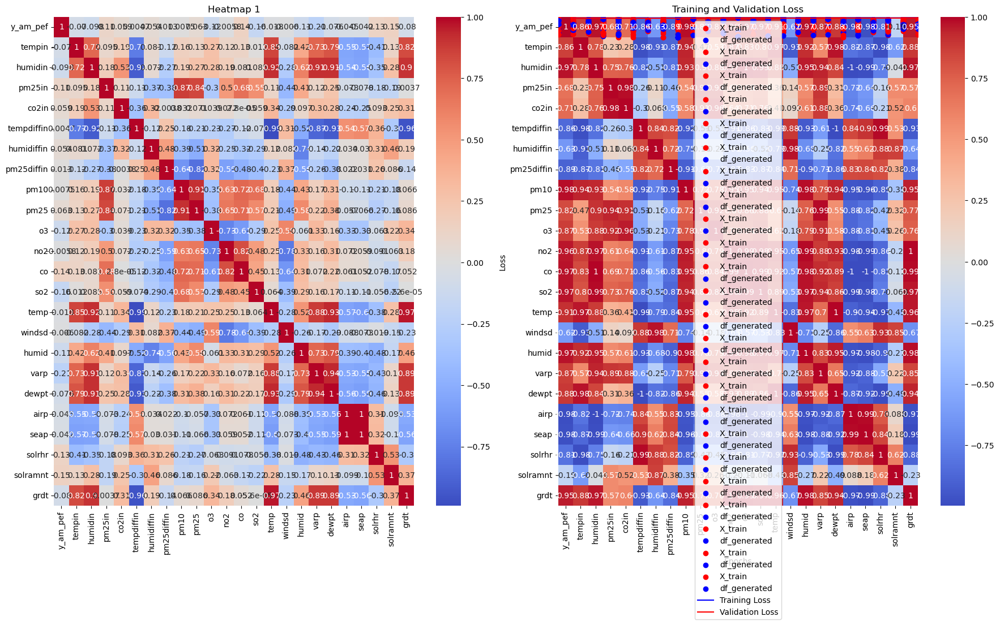

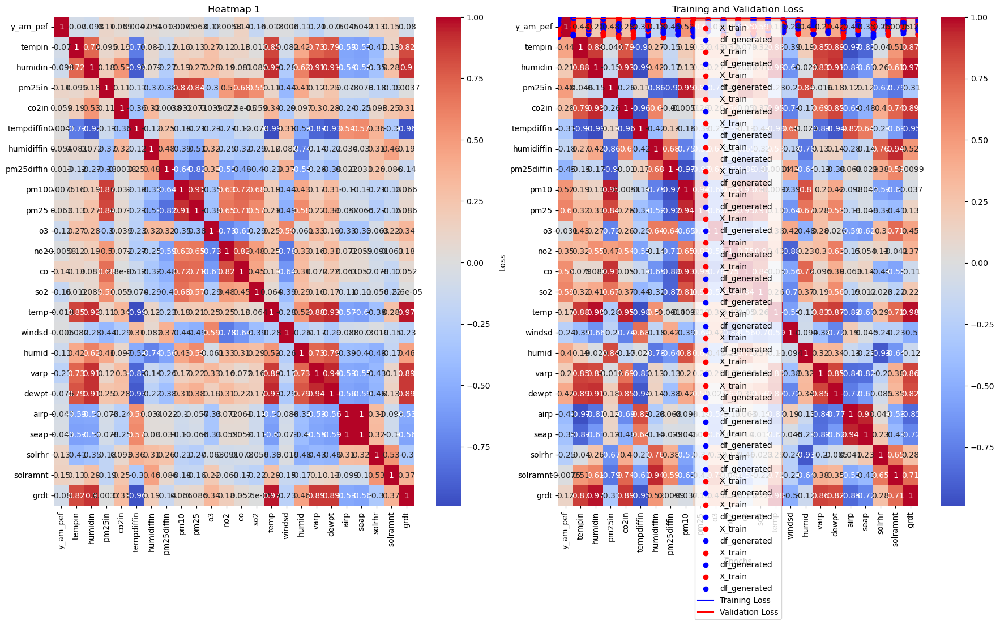

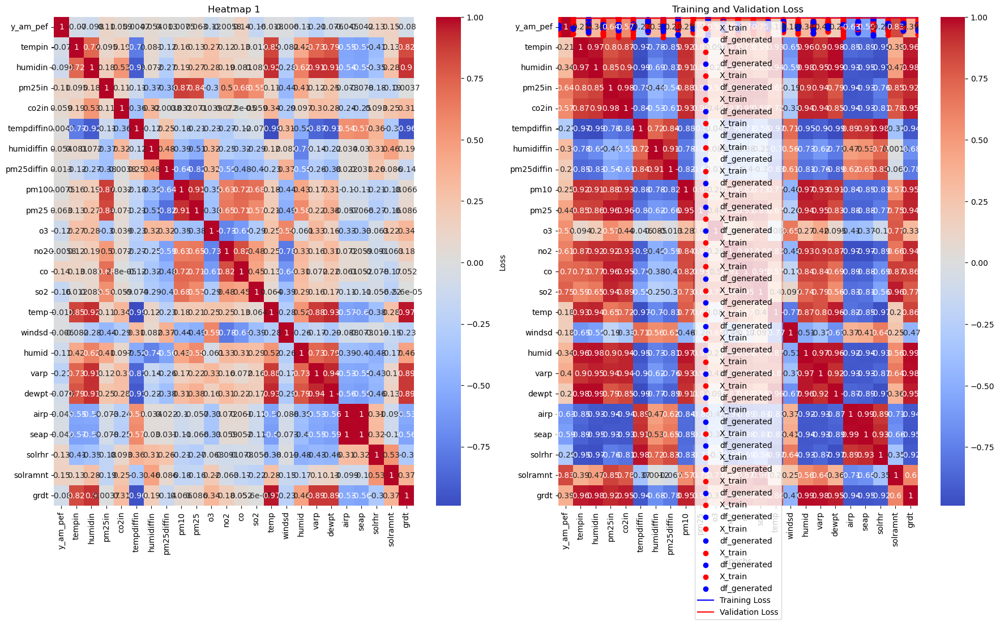

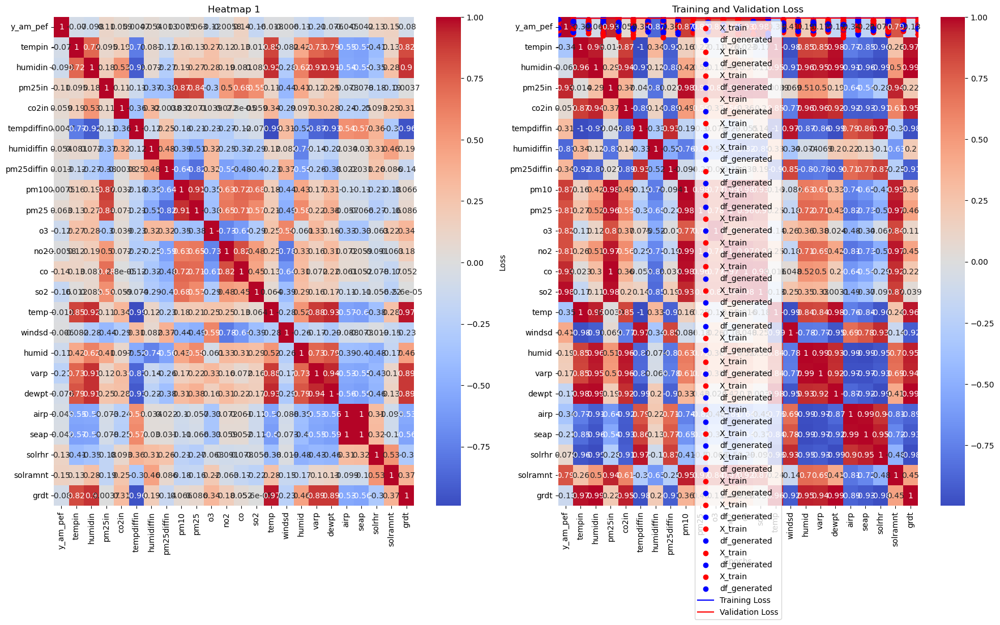

...

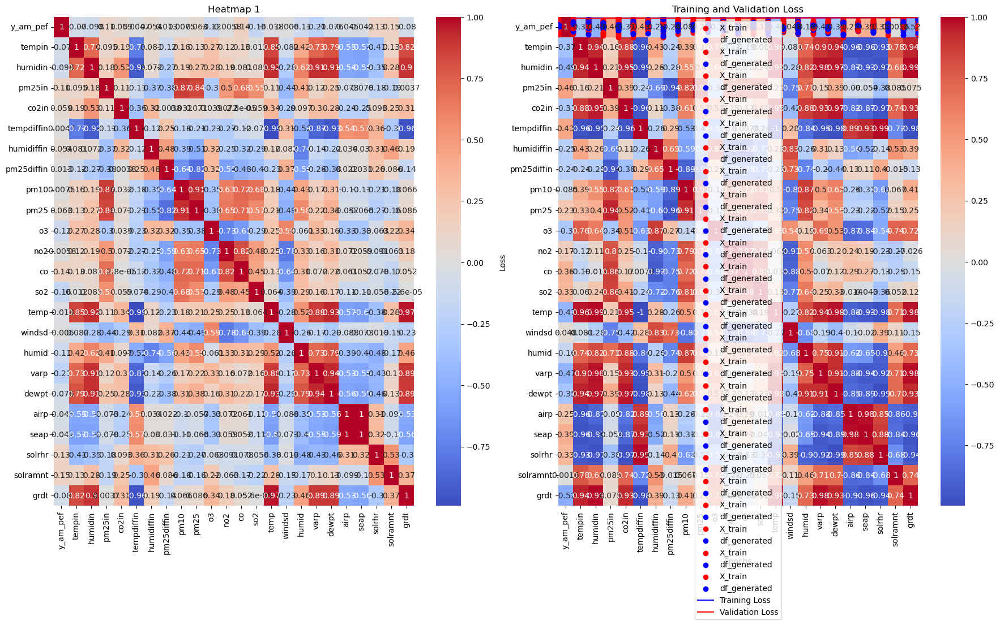

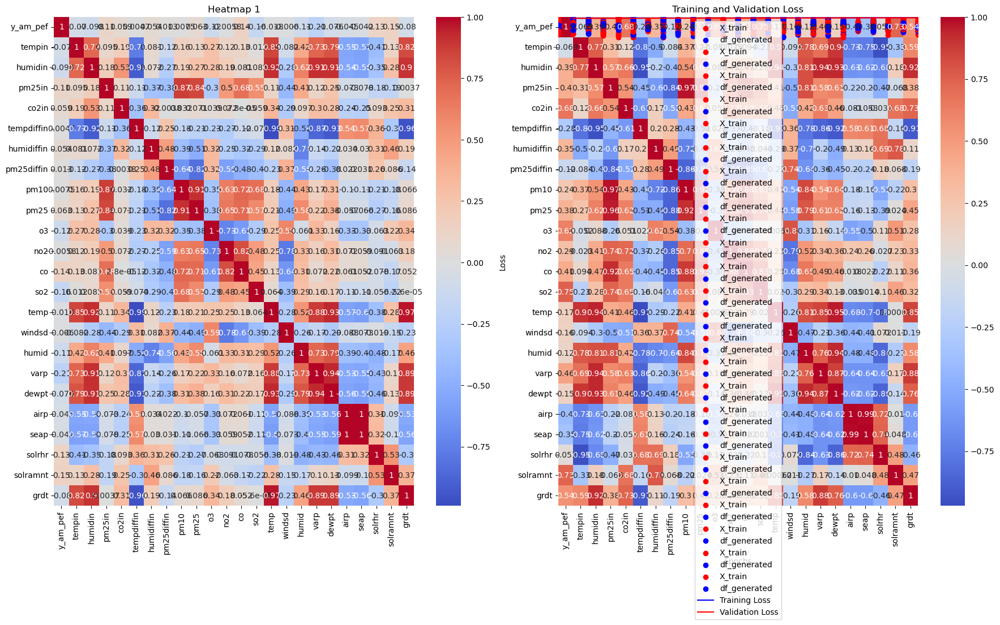

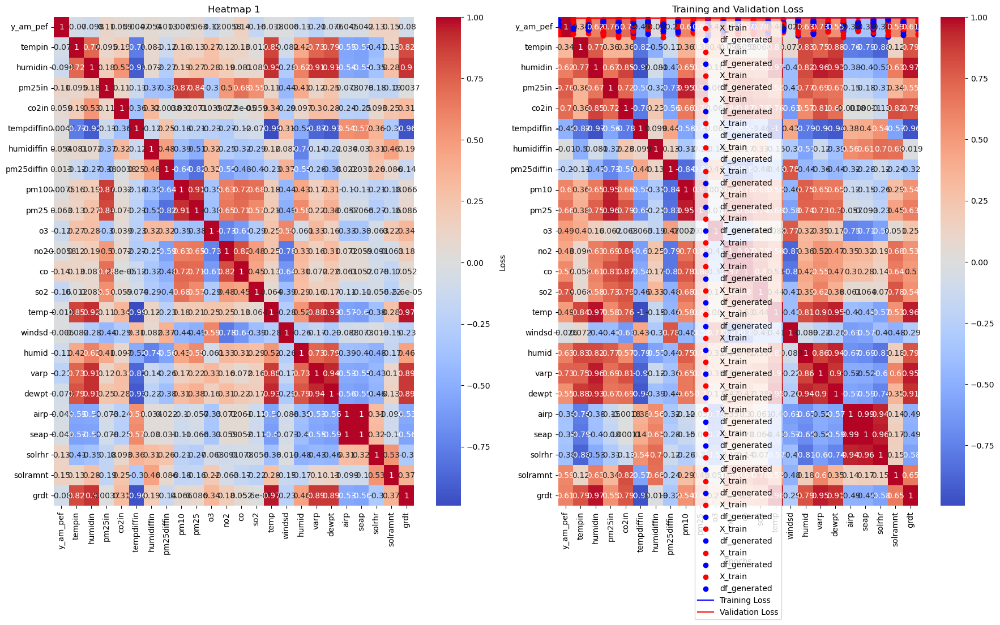

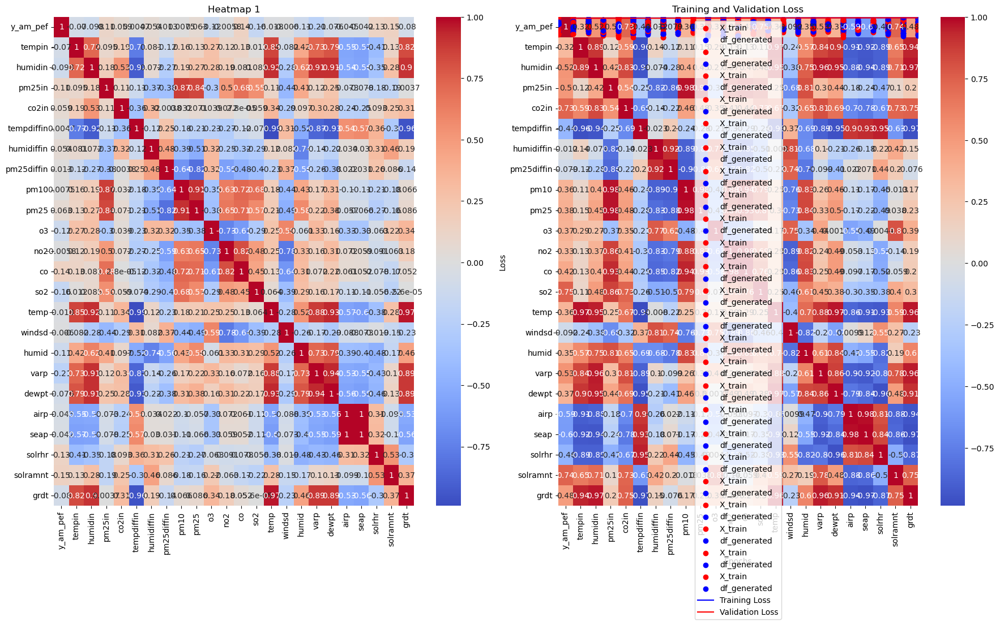

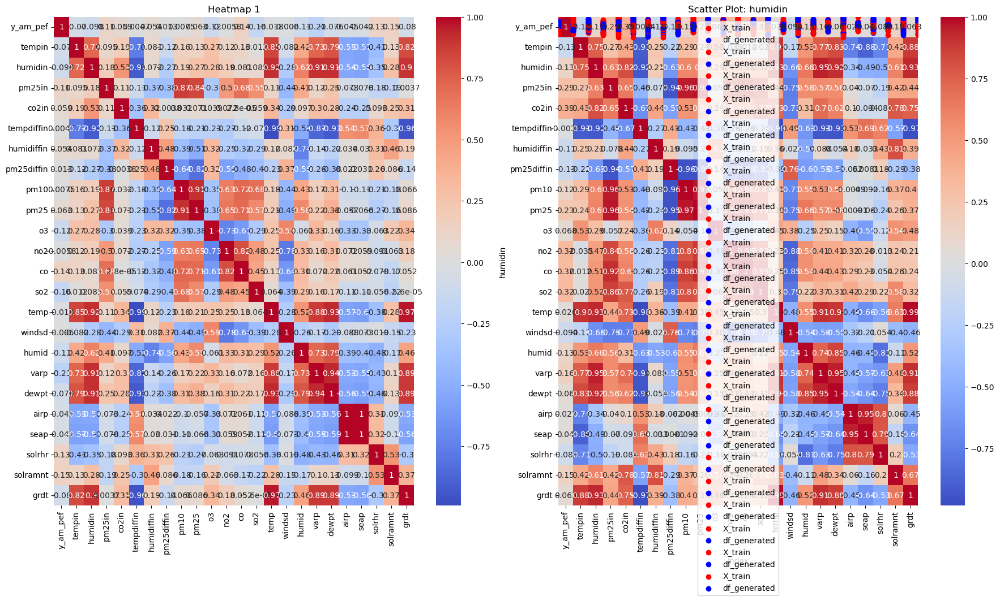

In [11]:
start_time = time.time()

for bn in bottle_neck_trial:
  for enc_layers in encoder_dense_layers_trial:
      for dec_layers in decoder_dense_layers_trial:
          print(enc_layers, bn, dec_layers)
          runner(enc_layers, bn, dec_layers)
                
end_time = time.time()
total_time = end_time - start_time                
total_time_minutes = total_time / 60
print(f"Total time: {total_time_minutes} minutes") 

In [12]:
import csv
#save run_summary as a file
filename = 'run_summary.csv'

with open(filename, 'w', newline='') as file:
    writer = csv.writer(file)
    writer.writerows(run_summary)

print(f"Run summary has saved: {filename}")

Run summary has saved: run_summary.csv


In [13]:
run_summary.sort(key=lambda x: x[1], reverse=True)  # Sort by the middle value in descending order

top_10 = run_summary[:10]  # Get the top 10 elements

for item in top_10:
    print(item)

['L24_E10_8_B16_D6_8_10_12', 0.01924319937825203, 0.031772904098033905]
['L24_E14_12_B16_D8_10_12_14', 0.018290258944034576, 0.028182514011859894]
['L24_E16_14_B16_D10_12_14_16', 0.017954345792531967, 0.02919999696314335]
['L24_E10_8_B16_D12_14_16_18', 0.01793283224105835, 0.027617322281003]
['L24_E10_8_B16_D10_12_14_16', 0.017910106107592583, 0.02662251517176628]
['L24_E12_10_B16_D6_8_10_12', 0.01625249534845352, 0.023979125544428825]
['L24_E22_20_B16_D6_8_10_12', 0.015576638281345367, 0.02483651041984558]
['L24_E10_8_B16_D14_16_18_20', 0.015073753893375397, 0.023402266204357147]
['L24_E16_14_B16_D6_8_10_12', 0.014730975963175297, 0.0250517800450325]
['L24_E20_18_B16_D6_8_10_12', 0.013803541660308838, 0.02053818479180336]


In [14]:
for item in run_summary:
    print(item)

['L24_E10_8_B16_D6_8_10_12', 0.01924319937825203, 0.031772904098033905]
['L24_E14_12_B16_D8_10_12_14', 0.018290258944034576, 0.028182514011859894]
['L24_E16_14_B16_D10_12_14_16', 0.017954345792531967, 0.02919999696314335]
['L24_E10_8_B16_D12_14_16_18', 0.01793283224105835, 0.027617322281003]
['L24_E10_8_B16_D10_12_14_16', 0.017910106107592583, 0.02662251517176628]
['L24_E12_10_B16_D6_8_10_12', 0.01625249534845352, 0.023979125544428825]
['L24_E22_20_B16_D6_8_10_12', 0.015576638281345367, 0.02483651041984558]
['L24_E10_8_B16_D14_16_18_20', 0.015073753893375397, 0.023402266204357147]
['L24_E16_14_B16_D6_8_10_12', 0.014730975963175297, 0.0250517800450325]
['L24_E20_18_B16_D6_8_10_12', 0.013803541660308838, 0.02053818479180336]
['L24_E14_12_B16_D10_12_14_16', 0.013240385800600052, 0.030265463516116142]
['L24_E10_8_B16_D16_18_20_22', 0.012538550421595573, 0.02016659453511238]
['L24_E20_18_B16_D10_12_14_16', 0.011971360072493553, 0.019383005797863007]
['L24_E12_10_B16_D12_14_16_18', 0.0118762